In [1]:
import pandas as pd 
import numpy as np
import json
from collections import Counter

import re
import string
from wordcloud import WordCloud
from sklearn.feature_extraction.text import CountVectorizer

import spacy
from spacy import displacy
nlp = spacy.load("en_core_web_md")
import textacy
from textacy import extract
from textacy import preprocessing

import matplotlib.pyplot as plt
import seaborn as sns
#sns.set_style('whitegrid')
%matplotlib inline

import warnings
warnings.simplefilter("ignore", DeprecationWarning)

from sklearn.decomposition import LatentDirichletAllocation as LDA
from pyLDAvis import sklearn as sklearn_lda
import pickle 
import pyLDAvis

from bokeh.io import output_file, show, output_notebook
from bokeh.models import ColumnDataSource
from bokeh.palettes import Category20b, cividis, inferno
from bokeh.plotting import figure
from bokeh.transform import factor_cmap, cumsum
from math import pi

## ~~~~~~~~ Helpers ~~~~~~~~

In [2]:
def flatten_list(_2d_list):
    flat_list = []
    # Iterate through the outer list
    for element in _2d_list:
        if type(element) is list:
            # If the element is of type list, iterate through the sublist
            for item in element:
                flat_list.append(item)
        else:
            flat_list.append(element)
    return flat_list

## Read in data

In [3]:
f = open('steamdb.json')
data = json.load(f)

In [4]:
len(data)

53981

In [7]:
df = pd.DataFrame(data)

In [8]:
df.columns

Index(['sid', 'store_url', 'store_promo_url', 'store_uscore',
       'published_store', 'published_meta', 'published_stsp', 'published_hltb',
       'published_igdb', 'image', 'name', 'description', 'full_price',
       'current_price', 'discount', 'platforms', 'developers', 'publishers',
       'languages', 'voiceovers', 'categories', 'genres', 'tags',
       'achievements', 'gfq_url', 'gfq_difficulty', 'gfq_difficulty_comment',
       'gfq_rating', 'gfq_rating_comment', 'gfq_length', 'gfq_length_comment',
       'stsp_owners', 'stsp_mdntime', 'hltb_url', 'hltb_single',
       'hltb_complete', 'meta_url', 'meta_score', 'meta_uscore', 'grnk_score',
       'igdb_url', 'igdb_single', 'igdb_complete', 'igdb_score', 'igdb_uscore',
       'igdb_popularity'],
      dtype='object')

In [9]:
df.describe()

,sid,store_uscore,full_price,current_price,discount,achievements,gfq_rating,gfq_length,stsp_owners,stsp_mdntime,hltb_single,hltb_complete,meta_score,meta_uscore,grnk_score,igdb_single,igdb_complete,igdb_score,igdb_uscore,igdb_popularity
count,5.398100e+04,33462.000000,46817.000000,46817.000000,6529.000000,28716.000000,13491.000000,10710.000000,3.546600e+04,9265.000000,14767.000000,12548.000000,3700.000000,6012.000000,5128.000000,237.000000,191.000000,4513.000000,12605.000000,21084.000000
mean,9.590521e+05,70.453709,907.910631,849.008117,45.406494,47.542102,3.333742,17.647460,1.247585e+05,440.549703,8.745107,22.940309,71.397297,68.659847,68.723089,17.075949,37.136126,70.254598,64.685918,2.649404
std,4.701868e+05,19.691413,1101.039441,1070.449886,22.180186,290.917125,0.856304,19.267047,1.415364e+06,2235.980563,56.380258,104.066676,11.097859,14.410269,14.224267,23.369783,64.806614,13.790916,13.441085,14.434892
min,1.000000e+01,1.000000,50.000000,49.000000,5.000000,1.000000,0.500000,0.500000,1.000000e+04,1.000000,1.000000,1.000000,19.000000,5.000000,10.000000,1.000000,1.000000,10.000000,11.000000,1.000000
25%,5.777600e+05,57.000000,299.000000,299.000000,25.000000,10.000000,3.000000,5.000000,1.000000e+04,73.000000,1.000000,2.000000,65.000000,62.000000,60.000000,3.000000,5.000000,63.000000,50.000000,1.000000
50%,9.386800e+05,75.000000,599.000000,500.000000,50.000000,19.000000,3.500000,10.400000,1.000000e+04,207.000000,4.000000,7.000000,73.000000,72.000000,70.000000,8.000000,12.000000,72.000000,70.000000,1.000000
75%,1.316230e+06,86.000000,1099.000000,999.000000,60.000000,34.000000,3.920000,20.200000,3.500000e+04,347.000000,9.000000,18.000000,79.000000,78.000000,80.000000,21.000000,38.500000,80.000000,74.000000,1.450000
max,1.979280e+06,100.000000,99900.000000,99900.000000,90.000000,9821.000000,5.000000,80.000000,1.500000e+08,137570.000000,5149.000000,4871.000000,96.000000,100.000000,100.000000,133.000000,400.000000,100.000000,100.000000,997.770000


## Correlate user score and game difficulty

In [10]:
df.groupby(['gfq_difficulty'])[['store_uscore']].mean().reset_index().sort_values(by=['store_uscore'])

,gfq_difficulty,store_uscore
8,Unforgiving,66.898551
7,Tough-Unforgiving,72.269231
6,Tough,73.793157
2,Just Right,74.008718
1,Easy-Just Right,75.061633
3,Just Right-Tough,75.236176
0,Easy,75.883629
4,Simple,77.049724
5,Simple-Easy,78.967742


In [11]:
df['gfq_difficulty'].dropna().unique()

array(['Just Right-Tough', 'Just Right', 'Easy-Just Right', 'Tough',
       'Tough-Unforgiving', 'Unforgiving', 'Easy', 'Simple',
       'Simple-Easy'], dtype=object)

## Price

(0.0, 60.0)

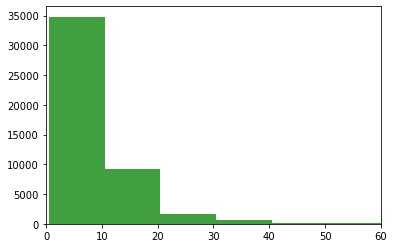

In [12]:
plt.hist(df['full_price'].dropna()*0.01, 100, density=False, facecolor='g', alpha=0.75)
plt.xlim(0, 60)

## User ratings 

In [13]:
def get_year(x):
    try:
        return x.split('-')[0] 
    except:
        return 'missing'

In [14]:
df['year'] = df['published_store'].apply(lambda x : get_year(x))

In [15]:
scores_by_year = df.groupby('year').mean(['store_uscore'])[['store_uscore']]

In [16]:
scores_by_year = scores_by_year.reset_index()

In [17]:
scores_by_year

,year,store_uscore
0,1997,87.000000
1,1998,96.000000
2,1999,89.500000
3,2000,89.000000
4,2001,88.750000
5,2002,89.000000
6,2003,80.333333
7,2004,91.166667
8,2005,81.857143
9,2006,83.126984


In [18]:
source = ColumnDataSource(data=dict(counted_data=scores_by_year.year, counts=scores_by_year.store_uscore))
p = figure(x_range=scores_by_year.year, plot_height=300, plot_width=600, toolbar_location=None, title='Scores')
    
p.vbar(x='counted_data',
    top='counts', 
    width=0.8, 
    source=source, 
    line_color='white', 
)
    
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None
p.y_range.start = 0
p.xaxis.major_label_orientation = 1.2
p.background_fill_color = 'white'
    
show(p)

## Genres

In [20]:
genres_per_game = df['genres'].tolist()
genres_per_game = [d.split(',') for d in genres_per_game]
genres = flatten_list(genres_per_game)

In [21]:
dict(Counter(genres).items())

{'Action': 23137,
 'Free to Play': 4193,
 'Strategy': 10495,
 'Adventure': 20738,
 'Indie': 39084,
 'RPG': 9412,
 'Casual': 21996,
 'Simulation': 10562,
 'Racing': 2029,
 'Massively Multiplayer': 1530,
 'Nudity': 171,
 'Violent': 662,
 'Sports': 2593,
 'Gore': 410,
 'Early Access': 7084,
 'Sexual Content': 159,
 'Movie': 1,
 'Game Development': 17,
 'Приключенческие игры': 1,
 'Инди': 1}

## Tags

In [22]:
tags_per_game = df['tags'].dropna().tolist()
tags_per_game = [d.split(',') for d in tags_per_game]
tags = flatten_list(tags_per_game)

In [23]:
tags_dict = dict(Counter(tags).items())

In [24]:
tags_df = pd.DataFrame.from_dict(tags_dict, orient='index')
tags_df.columns = ['count']

In [25]:
tags_df.sort_values('count', ascending=False).head(100)

,count
Indie,14731
Action,9835
Adventure,8386
Casual,7725
Singleplayer,4917
...,...
PvP,278
Isometric,275
Realistic,275
Dungeon Crawler,274


## Developers

In [26]:
developers_per_game = df['developers'].dropna().tolist()
developers_dict = dict(Counter(developers_per_game).items())

In [27]:
developers_df = pd.DataFrame.from_dict(developers_dict, orient='index')
developers_df.columns = ['count']

In [28]:
developers_df.sort_values(by='count', ascending=False).head(20)

,count
Choice of Games,132
Laush Dmitriy Sergeevich,113
Creobit,103
"KOEI TECMO GAMES CO., LTD.",92
Sokpop Collective,87
Hosted Games,79
Blender Games,71
Ripknot Systems,62
RewindApp,61
Elephant Games,60


## Publishers

In [29]:
publishers_per_game = df['publishers'].dropna().tolist()
publishers_dict = dict(Counter(publishers_per_game).items())

In [30]:
publishers_df = pd.DataFrame.from_dict(publishers_dict, orient='index')
publishers_df.columns = ['count']

In [31]:
publishers_df.sort_values(by='count', ascending=False).head(20)

,count
Big Fish Games,399
,277
8floor,167
Strategy First,153
Square Enix,144
SEGA,142
Sekai Project,135
Choice of Games,132
Laush Studio,131
Ubisoft,127


# NLP on Description

In [59]:
def simple_text_clean(text):
    text = re.sub('\n', ' ', text) 
    text = re.sub('\r', ' ', text) 
    text = preproc(text)
    return text

In [33]:
df['description']

0        Play the world's number 1 online action game. ...
1        One of the most popular online action games of...
2        Enlist in an intense brand of Axis vs. Allied ...
3        Enjoy fast-paced multiplayer gaming with Death...
4        Return to the Black Mesa Research Facility as ...
                               ...                        
53976    Kuggs is a fast-paced shooter with some light ...
53977    Grandma Studios invites you on the latest chil...
53978    Embark on a deadly journey for survival. Your ...
53979    Train your brain with this memory game, reveal...
53980    Challenging jigsaw puzzles, featuring adult im...
Name: description, Length: 53981, dtype: object

In [34]:
def text_to_bow(text):
    '''
    convert text to just lowercase words
    '''
    # optional if dealing with strings which might contain nan 
    if text == np.nan:
        return text 
    else: 
        text = str(text).lower()
        text = re.sub('\n', ' ', text) 
        text = re.sub('<br>', ' ', text) 
        # remove non alphanumeric characters
        regex = re.compile('[^0-9a-zA-Z- ]')
        text = regex.sub('', text)
        text = re.sub(' +', ' ', text).strip()
        return text

In [35]:
text_to_bow(df['description'][0])

'play the worlds number 1 online action game engage in an incredibly realistic brand of terrorist warfare in this wildly popular team-based game ally with teammates to complete strategic missions take out enemy sites rescue hostages your role affects your teams success your teams success affects your role'

In [36]:
df['description_bow'] = df['description'].apply(lambda x : text_to_bow(x))

### Bag of words

In [37]:
class BagOfWords:
    def __init__(self, data, max_df, min_df, stop_words, ngram_range):
        self.data = data
        self.max_df = max_df 
        self.min_df = min_df 
        self.stop_words = stop_words 
        self.ngram_range = ngram_range 
        self.MyCountVectorizer = CountVectorizer(
            max_df=self.max_df, 
            min_df=self.min_df, 
            stop_words=self.stop_words, 
            ngram_range=self.ngram_range)
        # init the empty vars 
        self.X = ""
        self.feature_names = ""
        self.counts = ""
        self.df_counts = ""
        self.dict_counts = ""
        self.wordcloud = ""
        self.p = ""
        
        
    #fit the count vectorizer 
    def fit_transform(self):
        self.X = self.MyCountVectorizer.fit_transform(self.data)
        
    def get_feature_names(self):
        self.feature_names = self.MyCountVectorizer.get_feature_names()
        
    def get_bow_feature_counts(self): 
        self.counts = self.X.toarray().sum(axis=0)
        # create a df with feature names and counts 
        self.df_counts = pd.DataFrame({"feature_names": self.feature_names, "counts": self.counts}).sort_values(by="counts", ascending=False)
    
    
        # get the data into a dict format of {word: freq} type to feed into the wordcloud 
    def prep_for_wordcloud(self):
        _dict_counts = self.df_counts.set_index("feature_names").to_dict(orient="index")
        self.dict_counts = {}
        for keyword, count in _dict_counts.items():
            self.dict_counts[keyword] = count['counts']
    
    # visualise the word cloud
    def viz_wordcloud(self, background_color="black", max_words=200, width=700, height=400):
        self.wordcloud = WordCloud(background_color=background_color, max_words=max_words, width=width, height=height)
        self.wordcloud.generate_from_frequencies(self.dict_counts)
        #self.wordcloud.to_image()
        
    # bar chart of word frequencies 
    def barchart_wordfreq(self, 
                          num_top_features=30,
                          output_here=True, save_filename="plot", 
                          plot_height=350, plot_width=800, title="Title", bgcolor = "#2b2b2b"):
        
        counted_data = self.df_counts.nlargest(num_top_features, "counts")["feature_names"].tolist()
        counts = self.df_counts.nlargest(num_top_features, "counts")["counts"].tolist()
        # either display in the notebook or save file 
        if output_here:
            output_notebook()
        else:
            output_file(save_filename+".html")
        
        source = ColumnDataSource(data=dict(counted_data=counted_data, counts=counts))
        self.p = figure(x_range=counted_data, plot_height=plot_height, plot_width=plot_width, toolbar_location=None, title=title)
    
        self.p.vbar(x='counted_data',
           top='counts', 
           width=0.8, 
           source=source, 
           line_color='white', 
           fill_color=factor_cmap('counted_data', palette=cividis(len(counted_data)), factors=counted_data))
    
        self.p.xgrid.grid_line_color = None
        self.p.ygrid.grid_line_color = None
        self.p.y_range.start = 0
        self.p.xaxis.major_label_orientation = 1.2
        #p.y_range.end = 5000
        self.p.background_fill_color = bgcolor
    
        show(self.p)

In [40]:
# initialize the count vectorizer 
bow = BagOfWords(data=df['description_bow'], max_df=0.8, min_df=0.005, stop_words="english", ngram_range=(1, 1))
# fit transform and get the fit-transformed matrix of word frequencies
bow.fit_transform() #bow_bow.X
# get the feature names 
bow.get_feature_names() #bow.feature_names
# get the feature counts 
bow.get_bow_feature_counts() #bow.df_counts

In [41]:
print("Number of features: {}".format(len(bow.feature_names)))

Number of features: 3097


In [42]:
bow.df_counts.head(10)

,feature_names,counts
1147,game,105017
1846,new,35979
3068,world,35495
1571,lili,31601
2020,play,30453
2764,time,28008
762,different,25924
2024,players,22549
1557,levels,19862
2023,player,19406


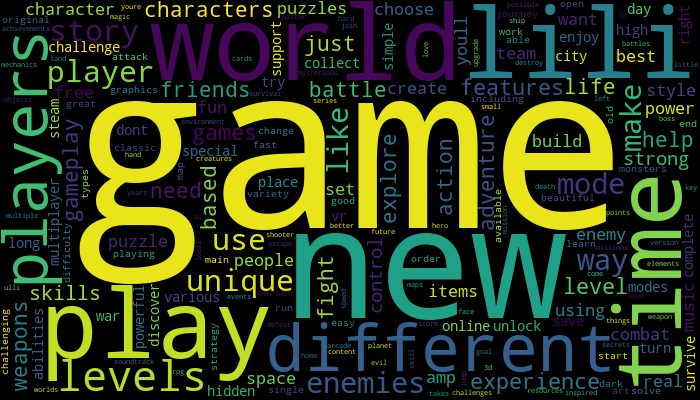

In [43]:
# wordcloud 
bow.prep_for_wordcloud()
bow.viz_wordcloud()
bow.wordcloud.to_image()

In [44]:
bow.barchart_wordfreq(num_top_features=50, plot_width=1000)
#show(bow.p)

Loading BokehJS ...

## POS Patterns

In [45]:
patterns = [
    [{"POS" : "VERB"}, {"POS" : "ADV"}],
    #[{"POS" : "VERB"}, {"POS" : "NOUN"}],
    [{"POS" : "ADJ"}, {"POS" : "NOUN"}]
]

In [46]:
def get_patterns(text):
    doc = nlp(text)
    pattern = textacy.extract.matches.token_matches(doc, patterns=patterns)
    return list(pattern)

In [51]:
sample = df['description'].dropna().sample(10000).tolist()
patterns_sample = []
for desc in sample: 
    pattern = get_patterns(desc)
    if (len(pattern) > 0):
        patterns_sample.append(pattern)

In [52]:
patterns_sample_flat = flatten_list(patterns_sample)
patterns_sample_flat = [str(d) for d in patterns_sample_flat]

In [53]:
patterns_sample_df = pd.DataFrame.from_dict(
    dict(Counter(patterns_sample_flat).items()), orient='index', columns=['count']
).sort_values(by='count', ascending=False).head(30)

In [54]:
patterns_sample_df

,count
other players,379
single player,249
open world,221
visual novel,217
first person,179
same time,177
virtual reality,171
main character,164
different types,137
first time,136


## Key terms

In [55]:
sample_entry = df['description'].dropna().tolist()[1]

In [56]:
textacy.extract.keyterms.textrank(nlp(sample_entry), normalize="lemma", topn=10)

/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)


[('popular online action game', 0.10362860280377198),
 ('online team warfare', 0.09343172882347828),
 ('game play mode', 0.06162725599651755),
 ('Team Fortress Classic', 0.05988255177997531),
 ('character class', 0.052344869965660804),
 ('unique weapon', 0.048876264259795604),
 ('unique style', 0.048508558467738966),
 ('Demolition Man', 0.03942164796752971),
 ('Medic', 0.020212235228716246),
 ('ability', 0.017890077756643266)]

In [66]:
sample_indie_games = df[df['genres'].apply(lambda x : 'Indie' in x)]['description'].dropna().tolist()
sample_indie_games = [(d) for d in sample_indie_games]

In [67]:
len(sample_indie_games)

39074

In [ ]:
keywords_all = []
keywords_all_list = []
for game in sample_indie_games:
    keywords = textacy.extract.keyterms.textrank(nlp(game), normalize="lemma", topn=5)
    keywords_words = [list(d)[0] for d in keywords]
    keywords_all.extend(list(keywords))
    keywords_all_list.extend(keywords_words)

/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be rem

In [69]:
pd.DataFrame.from_dict(dict(Counter(keywords_all_list).items()), orient='index', columns=['count']).sort_values(by='count', ascending=False).head(50)

,count
puzzle game,526
game mode,382
game,328
level,287
adventure game,263
new level,219
different level,216
new game,201
different game mode,201
main character,184


In [71]:
sample_action_games = df[df['genres'].apply(lambda x : 'Action' in x)]['description'].dropna().tolist()
sample_action_games = [(d) for d in sample_action_games]

In [72]:
keywords_all = []
keywords_all_list = []
for game in sample_action_games:
    keywords = textacy.extract.keyterms.textrank(nlp(game), normalize="lemma", topn=5)
    keywords_words = [list(d)[0] for d in keywords]
    keywords_all.extend(list(keywords))
    keywords_all_list.extend(keywords_words)

/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be rem

In [73]:
pd.DataFrame.from_dict(dict(Counter(keywords_all_list).items()), orient='index', columns=['count']).sort_values(by='count', ascending=False).head(50)

,count
game mode,277
different weapon,174
different game mode,163
action game,155
new weapon,152
new level,141
different enemy,140
game,137
level,116
different level,116


In [74]:
sample_adventure_games = df[df['genres'].apply(lambda x : 'Adventure' in x)]['description'].dropna().tolist()
sample_adventure_games = [(d) for d in sample_adventure_games]

In [75]:
keywords_all = []
keywords_all_list = []
for game in sample_adventure_games:
    keywords = textacy.extract.keyterms.textrank(nlp(game), normalize="lemma", topn=5)
    keywords_words = [list(d)[0] for d in keywords]
    keywords_all.extend(list(keywords))
    keywords_all_list.extend(keywords_words)

/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be rem

In [76]:
pd.DataFrame.from_dict(dict(Counter(keywords_all_list).items()), orient='index', columns=['count']).sort_values(by='count', ascending=False).head(50)

,count
adventure game,301
Hidden Object Puzzle Adventure game,193
main character,151
game,142
puzzle game,140
Edition includes:<br,115
new game,107
game world,99
different level,97
video game,93


In [77]:
sample_casual_games = df[df['genres'].apply(lambda x : 'Casual' in x)]['description'].dropna().tolist()
sample_casual_games = [(d) for d in sample_casual_games]

In [78]:
keywords_all = []
keywords_all_list = []
for game in sample_casual_games:
    keywords = textacy.extract.keyterms.textrank(nlp(game), normalize="lemma", topn=5)
    keywords_words = [list(d)[0] for d in keywords]
    keywords_all.extend(list(keywords))
    keywords_all_list.extend(keywords_words)

/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be removed in NetworkX 3.0, use networkx.pagerank instead.
  return nx.pagerank_scipy(graph, weight=weight, **kwargs)
/Users/dea/opt/anaconda3/lib/python3.9/site-packages/textacy/representations/network.py:267: DeprecationWarning: networkx.pagerank_scipy is deprecated and will be rem

In [79]:
pd.DataFrame.from_dict(dict(Counter(keywords_all_list).items()), orient='index', columns=['count']).sort_values(by='count', ascending=False).head(50)

,count
puzzle game,441
level,230
game,225
game mode,222
Hidden Object Puzzle Adventure game,192
new level,147
different level,142
beautiful girl,134
different game mode,129
Edition includes:<br,116


## Preprocessing

In [80]:
preproc = preprocessing.make_pipeline(
    preprocessing.replace.hashtags,
    preprocessing.replace.user_handles,
    preprocessing.replace.emojis,
    preprocessing.remove.accents,
    preprocessing.remove.html_tags,
    preprocessing.normalize.whitespace
    #preprocessing.remove.punctuation
)

## Text similarity

- How similar are the descriptions of games within the same genre?

In [82]:
textacy.similarity.edits.jaro(df['description'].dropna().tolist()[4], df['description'].dropna().tolist()[5])

0.661875098827387

In [87]:
sample_games = df[df['genres'].apply(lambda x : 'Action' in x)].sample(5000)['description'].dropna().tolist()
sample_games = [(d) for d in sample_games]

In [88]:
sample_games_similarities = []
for i in range(len(sample_games)):
    for j in range(len(sample_games)):
        if (i < j):
            similarity = textacy.similarity.edits.jaro(sample_games[i], sample_games[j])
            sample_games_similarities.append(similarity)
            if (similarity > 0.9):
                print('1:', sample_games[i])
                print('\n')
                print('2:', sample_games[j])
                print('\n')
                print('\n')

1: Find the objects that are hidden on the map.<br>
<br>
The game is a Hidden Object Game. <br>
In which you need to find objects with a certain design in beautiful locations, and click on them with the mouse.<br>
<br>
<br>
The game is a 3D level game in which objects and characters are frozen in the picture, you have to find 20 different objects. The system automatically determines which object you need to find at the moment, so the game has a high replay value, you will need to search for different objects each time.


2: Find the objects that are hidden on the map.<br>
<br>
The game is a Hidden Object Game. <br>
In which you need to find objects with a certain design in beautiful locations, and click on them with the mouse.<br>
<br>
<br>
The game is a 2D level pixel game in which objects and characters are frozen in the picture, you have to find 20 different objects. The system automatically determines which object you need to find at the moment, so the game has a high replay value,

In [85]:
np.mean(sample_action_games_similarities)

0.6528470781516444

In [86]:
textacy.similarity.edits.jaro('The cat is cute', 'The dog is cute')

0.8666666666666667

## Word in context

In [522]:
txt = df['description'].tolist()[2]

In [523]:
doc = nlp(txt)

In [524]:
pattern = list(extract.keyword_in_context(doc, "game", window_width=30, pad_context=True))

In [525]:
pattern

[]

## Part of speech

In [48]:
wanted_pos = ['PROPN', "VERB", "NOUN", "ADV", "ADJ"]

In [49]:
# for a single string of text, return a list of the words of the desired pos type
# and a list of the corresponding lemmas 
def collect_pos(pos, text, stopword=False):
    pos_text = []
    pos_lemma = []
    doc = nlp(text)
    for token in doc:
        if token.pos_ == pos and token.is_stop == False:
            pos_text.append(token.text)
            pos_lemma.append(token.lemma_)
    return pos_text, pos_lemma

In [50]:
def collect_noun_chunks(text):
    noun_chunks = []
    doc = nlp(text)
    for chunk in doc.noun_chunks:
        noun_chunks.append(chunk.text)
    return noun_chunks

In [70]:
noun_chunks = []
for text in df["description_bow"].tolist():
    noun_chunks.extend(collect_noun_chunks(text))
noun_chunks_counts = pd.Series(noun_chunks).value_counts()

In [71]:
noun_chunks_counts.head(20)

you           210785
that           46711
it             45382
the game       26624
them           23782
they           20013
who            18031
which          16684
we             15259
he             13524
what           13439
this           11938
the world      11607
i              11344
she            10052
this game       8587
all             7768
yourself        7276
the player      6600
enemies         6366
dtype: int64

In [51]:
def collect_pos(text):
    doc = nlp(text)
    nouns, verbs, adverbs, adjectives, other_pos = [], [], [], [], []
    for token in doc: 
        if token.pos_ == "NOUN" or token.pos_ == "PROPN":
            nouns.append(token.lemma_)
        elif token.pos_ == "VERB":
            verbs.append(token.lemma_)
        elif token.pos_ == "ADV":
            adverbs.append(token.lemma_)
        elif token.pos_ == "ADJ":
            adjectives.append(token.lemma_)
        else:
            other_pos.append(token.text)
    return nouns, verbs, adverbs, adjectives, other_pos

In [52]:
nouns_all, verbs_all, adverbs_all, adjectives_all, other_pos_all =  [], [], [], [], []
for text in df['description_bow'].tolist():
    nouns, verbs, adverbs, adjectives, other_pos = collect_pos(text)
    nouns_all.extend(nouns)
    verbs_all.extend(verbs)
    adverbs_all.extend(adverbs)
    adjectives_all.extend(adjectives)
    other_pos_all.extend(other_pos)

In [53]:
all_pos = {}
all_pos['nouns'] = len(nouns_all)
all_pos['verbs'] = len(verbs_all)
all_pos['adverbs'] = len(adverbs_all)
all_pos['adjectives'] = len(adjectives_all)

In [54]:
data_viz = pd.DataFrame.from_dict(all_pos, orient="index").reset_index()
data_viz.columns = ['pos', 'value']

In [55]:
data_viz

,pos,value
0,nouns,3576382
1,verbs,1542137
2,adverbs,364225
3,adjectives,1122006


In [57]:
#data = pd.DataFrame({"pos": ["nouns", "verbs"], "value" : [len(all_nouns), len(all_verbs)]})
data_viz['angle'] = data_viz['value']/data_viz['value'].sum() * 2*pi
data_viz['color'] = cividis(4)

p = figure(plot_height=350, title="Frequency of each pos type", toolbar_location=None,
           tools="hover", tooltips="@pos: @value", x_range=(-0.5, 1.0))

p.wedge(x=0, y=1, radius=0.4,
        start_angle=cumsum('angle', include_zero=True), end_angle=cumsum('angle'),
        line_color="white", fill_color='color', legend_field='pos', source=data_viz)

p.axis.axis_label=None
p.axis.visible=False
p.grid.grid_line_color = None

show(p)

In [63]:
nouns_df = pd.DataFrame.from_dict(dict(Counter(nouns_all).items()), orient='index')
nouns_df.columns = ['count']
nouns_df.sort_values(by='count', ascending=False).head(20)

,count
game,120063
player,41549
world,39857
level,34030
lili,31262
time,30555
enemy,26033
mode,23483
character,22197
story,20841


In [67]:
adj_df = pd.DataFrame.from_dict(dict(Counter(adjectives_all).items()), orient='index')
adj_df.columns = ['count']
adj_df.sort_values(by='count', ascending=False).head(20)

,count
new,35456
different,25858
more,21396
unique,19143
own,17450
other,16946
good,13258
many,12744
strong,10674
first,10339


In [68]:
verbs_df = pd.DataFrame.from_dict(dict(Counter(verbs_all).items()), orient='index')
verbs_df.columns = ['count']
verbs_df.sort_values(by='count', ascending=False).head(20)

,count
have,40574
play,30567
make,28344
use,28323
find,25002
get,23588
take,23445
go,14363
create,14198
be,13570


In [69]:
adv_df = pd.DataFrame.from_dict(dict(Counter(adverbs_all).items()), orient='index')
adv_df.columns = ['count']
adv_df.sort_values(by='count', ascending=False).head(20)

,count
also,14603
only,12953
just,11763
more,11702
even,11564
as,10678
so,9381
well,9092
now,9018
most,7431


In [342]:
displacy.render(nlp(df['description'].dropna().tolist()[7]), style="ent")